The goal here is to train ONE RBM, then I will use similar code to do hyperparametric search.

In [1]:
# Activate project
using Pkg
Pkg.activate("/Users/alessiogiorlandino/Desktop/SAM/Project.toml")
Base.active_project()
# Resolve dependencies
Pkg.resolve()

  Activating project at `~/Desktop/SAM`


  No Changes to `~/Desktop/SAM/Project.toml`
  No Changes to `~/Desktop/SAM/Manifest.toml`


In [2]:
import Rfam, Infernal, Logomaker, FASTX
using Optimisers: Adam
using EllipsisNotation: (..)
using FillArrays: Falses
import Makie, CairoMakie
using Makie: @colorant_str
import SamApp
using LinearAlgebra
using Statistics
using LaTeXStrings
using DelimitedFiles: readdlm

    CondaPkg Found dependencies: /Users/alessiogiorlandino/.julia/packages/Logomaker/DdglG/CondaPkg.toml


    CondaPkg Found dependencies: /Users/alessiogiorlandino/.julia/packages/PythonCall/dsECZ/CondaPkg.toml


    CondaPkg Dependencies already up to date


In [3]:
using BioSequences: LongRNA, @rna_str
using Statistics: mean, std, cor
import JLD2

using Plots
default(fmt = :png)

import RestrictedBoltzmannMachines as RBMs
import CudaRBMs, CenteredRBMs
using CudaRBMs: gpu, cpu
using CenteredRBMs: CenteredRBM, center, uncenter, center_from_data!
using RestrictedBoltzmannMachines: initialize!, RBM, xReLU, Potts, pcd!, Binary, log_pseudolikelihood, free_energy
using RBMsAnnealedImportanceSampling: aise, raise, logmeanexp, logstdexp, logvarexp

import RestrictedBoltzmannMachines
using MiniLoggers: global_logger, MiniLogger
global_logger(MiniLogger());

# Load sequence data from Rfam

In [4]:
cm = Infernal.cmfetch(Rfam.cm(), "RF00162")
natural_seed_stk = Infernal.esl_afetch(Rfam.seed(), "RF00162");
natural_seed_afa = Infernal.esl_reformat("afa", natural_seed_stk.out);
natural_seed_ids = FASTX.identifier.(FASTX.FASTA.Reader(open(natural_seed_afa.out)));

# Consensus secondary structure in WUSS format
seed_wuss = SamApp.stockholm_ss(natural_seed_stk.out)
seed_match_positions = findall(c -> c ≠ '.' && c ≠ '~', seed_wuss);

natural_hits_afa = Infernal.cmalign(Infernal.cmfetch(Rfam.cm(), "RF00162").out, Rfam.fasta_file("RF00162"); outformat="afa");
natural_hits_ids = FASTX.identifier.(FASTX.FASTA.Reader(open(natural_hits_afa.out)));

In [5]:
natural_seed_sequences_matchonly = map(FASTX.FASTA.Reader(open(natural_seed_afa.out))) do record
    FASTX.sequence(record)[seed_match_positions]
end

natural_hits_sequences_matchonly = map(FASTX.FASTA.Reader(open(natural_hits_afa.out))) do record
    filter(c -> !islowercase(c) && c ≠ '.', FASTX.sequence(record))
end

@assert only(unique(length.(natural_seed_sequences_matchonly))) == length(seed_match_positions) == 108
@assert only(unique(length.(natural_hits_sequences_matchonly))) == length(seed_match_positions) == 108

In [6]:
data_hits = SamApp.onehot(LongRNA{4}.(natural_hits_sequences_matchonly));
label_file = open("labels.txt","r")
label =readdlm("labels.txt")


6112×1 Matrix{Any}:
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 ⋮
 "other"
 "Bacteroidota"
 "Bacillota"
 "Bacteroidota"
 "Bacillota"
 "Bacteroidota"
 "Actinomycetota"
 "other"
 "other"

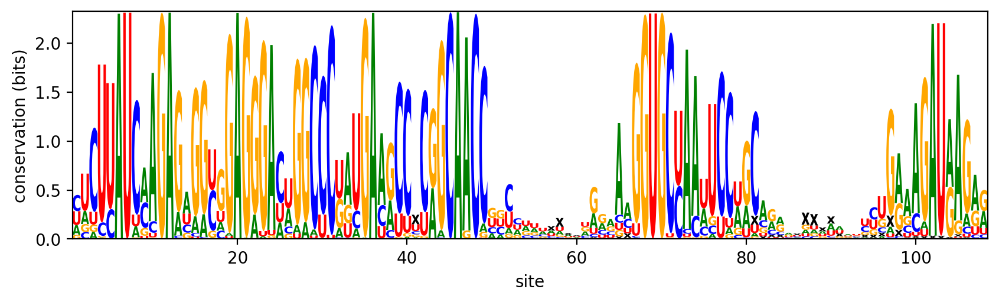

In [7]:
SamApp.seqlogo_entropic(reshape(mean(data_hits; dims=3), 5, 108)).fig

# PCA

In [8]:
function PCA(data)
    data_shape = size(data)
    cov_matrix = cov(data, dims=2)
    cov_eigenval = eigvals(cov_matrix)
    expl_ratio = cov_eigenval/sum(cov_eigenval)
    ort_trasf = eigvecs(cov_matrix)
    return transpose(ort_trasf)*data, expl_ratio,  ort_trasf
end
    


PCA (generic function with 1 method)

In [17]:
data_shape = size(data_hits)
data_flatten = reshape(data_hits, (data_shape[1]*data_shape[2], data_shape[3]))
data_flatten_rot, expl_ratio, O_v = PCA(data_flatten)


([0.474904001412625 0.4749040014126248 … 0.4749040014126278 0.47490400141263467; -0.31295950608130696 -0.3129595060813052 … -0.3129595060813021 -0.3129595060812951; … ; -0.002506256511098176 0.6624870089304071 … -0.23221503180757558 -1.5631329559374116; 4.1319333247054795 3.772432339699068 … 1.621676915562134 1.799416255177813], [-8.970479039948518e-18, -7.362424520834739e-18, -6.735700208217175e-18, -5.978263083096702e-18, -5.4738926432970576e-18, -5.015299434785437e-18, -4.784325133202614e-18, -4.625979005137508e-18, -4.3651150855584474e-18, -4.2426615574146734e-18  …  0.016413208835863433, 0.017429863202782468, 0.0212129701406351, 0.023391155420478784, 0.025243487653912815, 0.027956916862654006, 0.02993200365680448, 0.04387393386481623, 0.045843645289221066, 0.0721349168048522], [-0.005006075500965821 -0.0037353910306901273 … -0.024501985406433724 -0.027969274226703873; -0.005006075500965865 -0.003735391030689034 … 0.003868015550437953 0.03724768711020731; … ; -0.13785277425551506 -

# Train RBM

## RBM 1

In [30]:
# Sparsity parameter, as defined in Tubiana, RM, 2017 PRL (denoted \hat{p} there)
# This is smaller for sparser weights
function sparsity(rbm)
    num = sum(rbm.w.^2, dims=1:ndims(rbm.visible)).^2
    den = sum(rbm.w.^4, dims=1:ndims(rbm.visible))
    return sum(num ./ den) / length(rbm.w)
end

sparsity (generic function with 1 method)

In [11]:
function callback(; rbm, iter, kw...)
    if iszero(iter % 100)
        Δt = @elapsed (lpl = mean(log_pseudolikelihood(rbm, data)))
        if iszero(iter % 1000)
            @info iter lpl Δt
        end
        write(logfile, "$iter $lpl \n")
    end

end

callback (generic function with 1 method)

[2023-04-27 10:49:51] Info: 1000 lpl = -0.446402121544093, Δt = 0.246319208


[2023-04-27 10:50:38] Info: 2000 lpl = -0.38388803869437854, Δt = 0.268979416


[2023-04-27 10:51:27] Info: 3000 lpl = -0.3513724839969721, Δt = 0.349229417


[2023-04-27 10:52:17] Info: 4000 lpl = -0.3294713469619399, Δt = 0.288477208


[2023-04-27 10:53:06] Info: 5000 lpl = -0.31704032661983683, Δt = 0.272853917


[2023-04-27 10:53:52] Info: 6000 lpl = -0.3063435192919433, Δt = 0.254299375


[2023-04-27 10:54:39] Info: 7000 lpl = -0.29150330111146405, Δt = 0.289748667


[2023-04-27 10:55:31] Info: 8000 lpl = -0.3032323851958487, Δt = 0.321996917


[2023-04-27 10:56:29] Info: 9000 lpl = -0.280589659901791, Δt = 0.374962667


[2023-04-27 10:57:20] Info: 10000 lpl = -0.2728002058664738, Δt = 0.323764


[2023-04-27 10:58:16] Info: 11000 lpl = -0.26617251038498374, Δt = 0.347842375


[2023-04-27 10:59:21] Info: 12000 lpl = -0.2596573581609834, Δt = 0.268141375


[2023-04-27 11:00:08] Info: 13000 lpl = -0.25030924479927613, Δt = 0.265164542


[2023-04-27 11:00:53] Info: 14000 lpl = -0.2631531628011722, Δt = 0.273109042


[2023-04-27 11:01:37] Info: 15000 lpl = -0.2609170982580681, Δt = 0.264680041


[2023-04-27 11:02:23] Info: 16000 lpl = -0.2593232264736449, Δt = 0.267143833


[2023-04-27 11:03:08] Info: 17000 lpl = -0.2487304713584315, Δt = 0.264171208


[2023-04-27 11:03:52] Info: 18000 lpl = -0.24885051326120386, Δt = 0.267029166


[2023-04-27 11:04:37] Info: 19000 lpl = -0.2324759105234097, Δt = 0.272112458


[2023-04-27 11:05:22] Info: 20000 lpl = -0.2503725652945276, Δt = 0.270453708


[2023-04-27 11:06:09] Info: 21000 lpl = -0.2585012215342224, Δt = 0.287470334


[2023-04-27 11:06:56] Info: 22000 lpl = -0.23648467819711305, Δt = 0.270168125


[2023-04-27 11:07:42] Info: 23000 lpl = -0.23951559309526183, Δt = 0.272950334


[2023-04-27 11:08:28] Info: 24000 lpl = -0.2396058645004249, Δt = 0.284622083


[2023-04-27 11:09:13] Info: 25000 lpl = -0.23418077767807338, Δt = 0.27138175


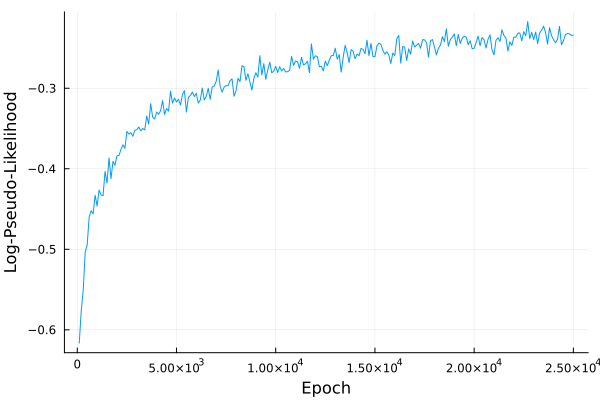

In [32]:
logfile = open("./Log/Stacked1.txt", "w+")


data = data_hits;
n_hidden1 = 256
rbm1 = center(RBM(Potts((5, 108)), Binary((n_hidden1,)), zeros(5, 108, n_hidden1)));
initialize!(rbm1, data);
pcd!(
    rbm1, data; 
    batchsize=256, iters=25000, steps=10, optim=Adam(1f-3), l1_weights=1f-3,
    vm=data[.., rand(1:size(data)[end], 256)], callback
);

close(logfile)

logdata = readdlm("./Log/Stacked1.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")

## RBM 2


[2023-04-27 11:09:29] Info: 1000 lpl = -0.4616141161130029, Δt = 0.03648975


[2023-04-27 11:09:44] Info: 2000 lpl = -0.4318732400340344, Δt = 0.037360084


[2023-04-27 11:09:58] Info: 3000 lpl = -0.4160857188199324, Δt = 0.038205625


[2023-04-27 11:10:11] Info: 4000 lpl = -0.41262112085952746, Δt = 0.038745542


[2023-04-27 11:10:24] Info: 5000 lpl = -0.40172848888643997, Δt = 0.04713925


[2023-04-27 11:10:37] Info: 6000 lpl = -0.39978296209801856, Δt = 0.039950125


[2023-04-27 11:10:51] Info: 7000 lpl = -0.3962917050196691, Δt = 0.039733791


[2023-04-27 11:11:04] Info: 8000 lpl = -0.3928670948840431, Δt = 0.040685833


[2023-04-27 11:11:17] Info: 9000 lpl = -0.38895180638711413, Δt = 0.040862666


[2023-04-27 11:11:31] Info: 10000 lpl = -0.38248618444021204, Δt = 0.040806709


[2023-04-27 11:11:44] Info: 11000 lpl = -0.39870089711002865, Δt = 0.040341667


[2023-04-27 11:11:57] Info: 12000 lpl = -0.3927434660326049, Δt = 0.040914791


[2023-04-27 11:12:11] Info: 13000 lpl = -0.38119425504938714, Δt = 0.040766167


[2023-04-27 11:12:24] Info: 14000 lpl = -0.36790170663911487, Δt = 0.04063175


[2023-04-27 11:12:37] Info: 15000 lpl = -0.37701496156631287, Δt = 0.040853292


[2023-04-27 11:12:50] Info: 16000 lpl = -0.3807362945532102, Δt = 0.040713167


[2023-04-27 11:13:04] Info: 17000 lpl = -0.3610043187571694, Δt = 0.041095458


[2023-04-27 11:13:17] Info: 18000 lpl = -0.36652308400741795, Δt = 0.041095083


[2023-04-27 11:13:30] Info: 19000 lpl = -0.3727661928660142, Δt = 0.040888708


[2023-04-27 11:13:44] Info: 20000 lpl = -0.36288349906949435, Δt = 0.041388791


[2023-04-27 11:13:57] Info: 21000 lpl = -0.3759324676954555, Δt = 0.041369041


[2023-04-27 11:14:10] Info: 22000 lpl = -0.3730307123565943, Δt = 0.041151292


[2023-04-27 11:14:24] Info: 23000 lpl = -0.3695629078522319, Δt = 0.041289083


[2023-04-27 11:14:37] Info: 24000 lpl = -0.37503457278408864, Δt = 0.041292583


[2023-04-27 11:14:51] Info: 25000 lpl = -0.3625044936075848, Δt = 0.041304709


[2023-04-27 11:15:04] Info: 26000 lpl = -0.35811820572570835, Δt = 0.04100975


[2023-04-27 11:15:17] Info: 27000 lpl = -0.37715481276115737, Δt = 0.04103075


[2023-04-27 11:15:31] Info: 28000 lpl = -0.35115100884768824, Δt = 0.04105975


[2023-04-27 11:15:44] Info: 29000 lpl = -0.37054313150523055, Δt = 0.040184792


[2023-04-27 11:15:58] Info: 30000 lpl = -0.3666264385045722, Δt = 0.040935875


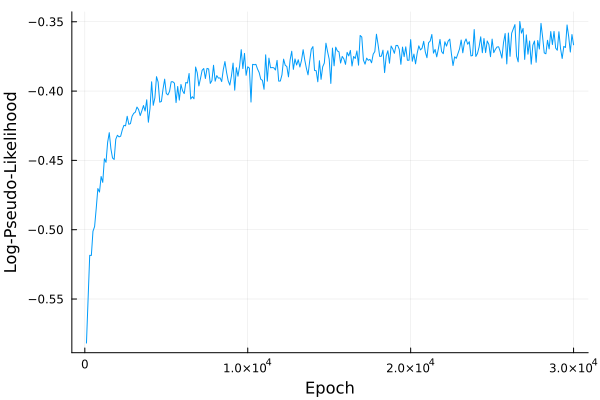

In [33]:
#Build data 
hidden_data1 = zeros(n_hidden1, data_shape[3])
for i in 1:data_shape[3]
    hidden_data1[:,i]=RestrictedBoltzmannMachines.sample_h_from_v(rbm1, data_hits[:,:,i]) 
end

logfile = open("./Log/Stacked2.txt", "w+")


n_hidden2 = 128
data = hidden_data1

rbm2 = center(RBM(Binary((n_hidden1,)), Binary((n_hidden2,)), zeros(n_hidden1, n_hidden2)));
initialize!(rbm2, data);

pcd!(
    rbm2, data; 
    batchsize=256, iters=30000, steps=10, optim=Adam(1f-3), l1_weights=1f-3,
    vm=hidden_data1[.., rand(1:size(hidden_data1)[end], 256)], callback
);

close(logfile)

logdata = readdlm("./Log/Stacked2.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood") 

## RBM 3


[2023-04-27 11:16:05] Info: 1000 lpl = -0.4798715615351573, Δt = 0.015472459


[2023-04-27 11:16:11] Info: 2000 lpl = -0.44176923671810886, Δt = 0.017423792


[2023-04-27 11:16:18] Info: 3000 lpl = -0.4166500274937483, Δt = 0.017898083


[2023-04-27 11:16:24] Info: 4000 lpl = -0.412105664313449, Δt = 0.01829975


[2023-04-27 11:16:31] Info: 5000 lpl = -0.41536389645377114, Δt = 0.018679458


[2023-04-27 11:16:37] Info: 6000 lpl = -0.42050615395884183, Δt = 0.0186585


[2023-04-27 11:16:44] Info: 7000 lpl = -0.41229800033536546, Δt = 0.018815208


[2023-04-27 11:16:50] Info: 8000 lpl = -0.4093585231968794, Δt = 0.018502458


[2023-04-27 11:16:57] Info: 9000 lpl = -0.3960644724694767, Δt = 0.018735208


[2023-04-27 11:17:03] Info: 10000 lpl = -0.4036556236008411, Δt = 0.017940667


[2023-04-27 11:17:09] Info: 11000 lpl = -0.3927935786510604, Δt = 0.018455625


[2023-04-27 11:17:16] Info: 12000 lpl = -0.4003578146147603, Δt = 0.018859209


[2023-04-27 11:17:23] Info: 13000 lpl = -0.3989516319898802, Δt = 0.018716125


[2023-04-27 11:17:29] Info: 14000 lpl = -0.39628825597567363, Δt = 0.018952042


[2023-04-27 11:17:35] Info: 15000 lpl = -0.38628607126153, Δt = 0.018894458


[2023-04-27 11:17:42] Info: 16000 lpl = -0.3998040659129165, Δt = 0.018904667


[2023-04-27 11:17:48] Info: 17000 lpl = -0.39083183512307423, Δt = 0.019024666


[2023-04-27 11:17:55] Info: 18000 lpl = -0.39870362249510655, Δt = 0.018957167


[2023-04-27 11:18:01] Info: 19000 lpl = -0.4037365780096259, Δt = 0.01894875


[2023-04-27 11:18:07] Info: 20000 lpl = -0.4032472014968476, Δt = 0.026931875


[2023-04-27 11:18:14] Info: 21000 lpl = -0.3887385530301198, Δt = 0.019223041


[2023-04-27 11:18:20] Info: 22000 lpl = -0.3870308255126429, Δt = 0.018186


[2023-04-27 11:18:27] Info: 23000 lpl = -0.38529158575662603, Δt = 0.0192295


[2023-04-27 11:18:33] Info: 24000 lpl = -0.3949273917729774, Δt = 0.019071583


[2023-04-27 11:18:39] Info: 25000 lpl = -0.3913276367476982, Δt = 0.018871584


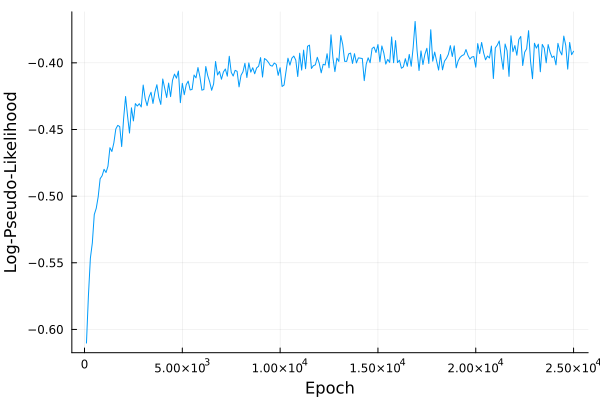

In [34]:
#Build data 
hidden_data2 = zeros(n_hidden2, data_shape[3])
for i in 1:data_shape[3]
    hidden_data2[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm2, hidden_data1[:,i]) 
end

logfile = open("./Log/Stacked3.txt", "w+")


n_hidden3 = 64
data=hidden_data2

rbm3 = center(RBM(Binary((n_hidden2,)), Binary((n_hidden3,)), zeros(n_hidden2, n_hidden3)));
initialize!(rbm3, data);

pcd!(
    rbm3, data; 
    batchsize=256, iters=25000, steps=10, optim=Adam(1f-3), l1_weights=1f-3,
    vm=hidden_data2[.., rand(1:size(hidden_data2)[end], 256)], callback
);

close(logfile)

logdata = readdlm("./Log/Stacked3.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")

## RBM 4

[2023-04-27 11:18:43] Info: 1000 lpl = -0.48219500702434387, Δt = 0.007194834


[2023-04-27 11:18:46] Info: 2000 lpl = -0.44411763780999886, Δt = 0.008315208


[2023-04-27 11:18:49] Info: 3000 lpl = -0.4236647779294384, Δt = 0.00803


[2023-04-27 11:18:53] Info: 4000 lpl = -0.39611232261539675, Δt = 0.0081215


[2023-04-27 11:18:56] Info: 5000 lpl = -0.38636348942923837, Δt = 0.008663625


[2023-04-27 11:18:59] Info: 6000 lpl = -0.40063264954161704, Δt = 0.008727041


[2023-04-27 11:19:02] Info: 7000 lpl = -0.3916597136283794, Δt = 0.008767667


[2023-04-27 11:19:06] Info: 8000 lpl = -0.39809554623676435, Δt = 0.00822725


[2023-04-27 11:19:09] Info: 9000 lpl = -0.3820603349574944, Δt = 0.018261167


[2023-04-27 11:19:12] Info: 10000 lpl = -0.3844521208350209, Δt = 0.008351125


[2023-04-27 11:19:16] Info: 11000 lpl = -0.3914813225779986, Δt = 0.008333292


[2023-04-27 11:19:19] Info: 12000 lpl = -0.3877935447173058, Δt = 0.008878417


[2023-04-27 11:19:22] Info: 13000 lpl = -0.37898663889541745, Δt = 0.008430416


[2023-04-27 11:19:26] Info: 14000 lpl = -0.37430905406339166, Δt = 0.008894167


[2023-04-27 11:19:29] Info: 15000 lpl = -0.3840538287871291, Δt = 0.008903875


[2023-04-27 11:19:32] Info: 16000 lpl = -0.3813450401795334, Δt = 0.008505667


[2023-04-27 11:19:36] Info: 17000 lpl = -0.38133966527764845, Δt = 0.008939625


[2023-04-27 11:19:39] Info: 18000 lpl = -0.3837708859310302, Δt = 0.0084185


[2023-04-27 11:19:42] Info: 19000 lpl = -0.38352427061223265, Δt = 0.008950542


[2023-04-27 11:19:46] Info: 20000 lpl = -0.3920474976025081, Δt = 0.008518625


[2023-04-27 11:19:49] Info: 21000 lpl = -0.3879534477156573, Δt = 0.008404917


[2023-04-27 11:19:53] Info: 22000 lpl = -0.3940169182156872, Δt = 0.008945


[2023-04-27 11:19:56] Info: 23000 lpl = -0.39401674840771206, Δt = 0.008956584


[2023-04-27 11:19:59] Info: 24000 lpl = -0.37972327732898803, Δt = 0.008886375


[2023-04-27 11:20:03] Info: 25000 lpl = -0.38449217054511475, Δt = 0.009034666


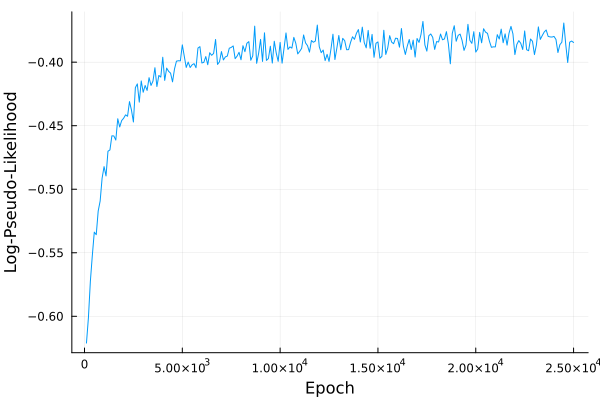

In [35]:
#Build data 
hidden_data3 = zeros(n_hidden3, data_shape[3])
for i in 1:data_shape[3]
    hidden_data3[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm3, hidden_data2[:,i]) 
end

logfile = open("./Log/Stacked4.txt", "w+")


n_hidden4 = 32
data = hidden_data3

rbm4 = center(RBM(Binary((n_hidden3,)), Binary((n_hidden4,)), zeros(n_hidden3, n_hidden4)));
initialize!(rbm4, data);

pcd!(
    rbm4, data; 
    batchsize=256, iters=25000, steps=10, optim=Adam(1f-3), l1_weights=1f-3,
    vm=hidden_data3[.., rand(1:size(hidden_data2)[end], 256)], callback
);

close(logfile)

logdata = readdlm("./Log/Stacked4.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")

# RBM 5


[2023-04-27 11:20:04] Info: 1000 lpl = -0.49854967984292897, Δt = 0.003554083


[2023-04-27 11:20:06] Info: 2000 lpl = -0.4598485989566645, Δt = 0.003866083


[2023-04-27 11:20:08] Info: 3000 lpl = -0.42527975529246825, Δt = 0.004136334


[2023-04-27 11:20:09] Info: 4000 lpl = -0.40990891220740794, Δt = 0.004086


[2023-04-27 11:20:11] Info: 5000 lpl = -0.3945872753209784, Δt = 0.004089292


[2023-04-27 11:20:12] Info: 6000 lpl = -0.3890325544347735, Δt = 0.003897792


[2023-04-27 11:20:14] Info: 7000 lpl = -0.38227793760479706, Δt = 0.003944416


[2023-04-27 11:20:16] Info: 8000 lpl = -0.37828852761182363, Δt = 0.004100667


[2023-04-27 11:20:17] Info: 9000 lpl = -0.3871583490476548, Δt = 0.004077542


[2023-04-27 11:20:19] Info: 10000 lpl = -0.3686986317170473, Δt = 0.004142708


[2023-04-27 11:20:20] Info: 11000 lpl = -0.3838290092269069, Δt = 0.004102417


[2023-04-27 11:20:22] Info: 12000 lpl = -0.36038635740890834, Δt = 0.003960417


[2023-04-27 11:20:24] Info: 13000 lpl = -0.37503202231098953, Δt = 0.004054542


[2023-04-27 11:20:25] Info: 14000 lpl = -0.3704370670712622, Δt = 0.004058125


[2023-04-27 11:20:27] Info: 15000 lpl = -0.3666456176035578, Δt = 0.004052125


[2023-04-27 11:20:29] Info: 16000 lpl = -0.37019352910664405, Δt = 0.004112292


[2023-04-27 11:20:30] Info: 17000 lpl = -0.3676187856499555, Δt = 0.004117167


[2023-04-27 11:20:32] Info: 18000 lpl = -0.36536784515104026, Δt = 0.003959209


[2023-04-27 11:20:34] Info: 19000 lpl = -0.38152013513063604, Δt = 0.005083375


[2023-04-27 11:20:36] Info: 20000 lpl = -0.37091431707520606, Δt = 0.004085292


[2023-04-27 11:20:37] Info: 21000 lpl = -0.3765664923052408, Δt = 0.004253666


[2023-04-27 11:20:39] Info: 22000 lpl = -0.36574547739032903, Δt = 0.003941166


[2023-04-27 11:20:41] Info: 23000 lpl = -0.3590737427788233, Δt = 0.0039795


[2023-04-27 11:20:42] Info: 24000 lpl = -0.36818438920024815, Δt = 0.004310791


[2023-04-27 11:20:44] Info: 25000 lpl = -0.36806012627977336, Δt = 0.004495958


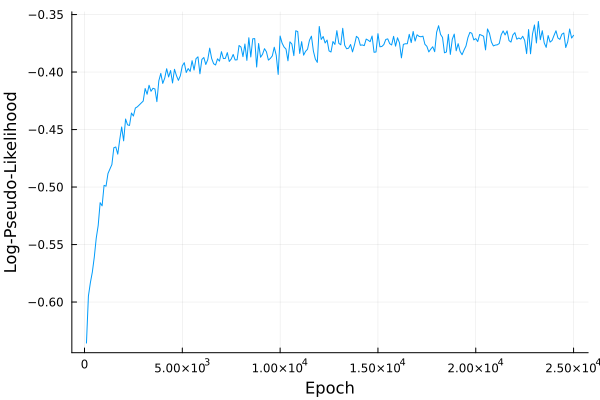

In [36]:
#Build data 
hidden_data4 = zeros(n_hidden4, data_shape[3])
for i in 1:data_shape[3]
    hidden_data4[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm4, hidden_data3[:,i]) 
end

logfile = open("./Log/Stacked5.txt", "w+")


n_hidden5 = 16
data = hidden_data4

rbm5 = center(RBM(Binary((n_hidden4,)), Binary((n_hidden5,)), zeros(n_hidden4, n_hidden5)));
initialize!(rbm5, data);

pcd!(
    rbm5, data; 
    batchsize=256, iters=25000, steps=10, optim=Adam(1f-3), l1_weights=1f-3,
    vm=hidden_data4[.., rand(1:size(hidden_data2)[end], 256)], callback
);

close(logfile)

logdata = readdlm("./Log/Stacked5.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")

[2023-04-27 11:20:45] Info: 1000 lpl = -0.530514663710359, Δt = 0.001127292


[2023-04-27 11:20:46] Info: 2000 lpl = -0.4954617819655824, Δt = 0.00119975


[2023-04-27 11:20:47] Info: 3000 lpl = -0.46060918314018423, Δt = 0.001244167


[2023-04-27 11:20:48] Info: 4000 lpl = -0.44772712101595336, Δt = 0.001223625


[2023-04-27 11:20:48] Info: 5000 lpl = -0.45170891060036256, Δt = 0.00111375


[2023-04-27 11:20:49] Info: 6000 lpl = -0.44237755983976756, Δt = 0.001132625


[2023-04-27 11:20:50] Info: 7000 lpl = -0.4230105679532356, Δt = 0.0012085


[2023-04-27 11:20:51] Info: 8000 lpl = -0.419608317782475, Δt = 0.001172959


[2023-04-27 11:20:52] Info: 9000 lpl = -0.4238844595767852, Δt = 0.001183125


[2023-04-27 11:20:53] Info: 10000 lpl = -0.41956097813832904, Δt = 0.001193125


[2023-04-27 11:20:53] Info: 11000 lpl = -0.4222625416950445, Δt = 0.001167125


[2023-04-27 11:20:54] Info: 12000 lpl = -0.42208395688298006, Δt = 0.001276292


[2023-04-27 11:20:55] Info: 13000 lpl = -0.42435663328824486, Δt = 0.001168667


[2023-04-27 11:20:56] Info: 14000 lpl = -0.416505080678043, Δt = 0.001199792


[2023-04-27 11:20:57] Info: 15000 lpl = -0.4040431665302312, Δt = 0.001176709


[2023-04-27 11:20:57] Info: 16000 lpl = -0.41299193979222143, Δt = 0.001456708


[2023-04-27 11:20:58] Info: 17000 lpl = -0.40892335045017075, Δt = 0.001317042


[2023-04-27 11:20:59] Info: 18000 lpl = -0.41679427489635495, Δt = 0.001934334


[2023-04-27 11:21:00] Info: 19000 lpl = -0.40760687182847966, Δt = 0.001328083


[2023-04-27 11:21:01] Info: 20000 lpl = -0.40809147554197167, Δt = 0.00128


[2023-04-27 11:21:01] Info: 21000 lpl = -0.40977807288821977, Δt = 0.001252083


[2023-04-27 11:21:02] Info: 22000 lpl = -0.41820179519806616, Δt = 0.001304416


[2023-04-27 11:21:03] Info: 23000 lpl = -0.4032490199037896, Δt = 0.001336584


[2023-04-27 11:21:04] Info: 24000 lpl = -0.41106683220527496, Δt = 0.00144675


[2023-04-27 11:21:05] Info: 25000 lpl = -0.3996286369098597, Δt = 0.001578916


[2023-04-27 11:21:06] Info: 26000 lpl = -0.40080666304122275, Δt = 0.003085834


[2023-04-27 11:21:07] Info: 27000 lpl = -0.40079566847942283, Δt = 0.001363959


[2023-04-27 11:21:08] Info: 28000 lpl = -0.4039313084239768, Δt = 0.001176792


[2023-04-27 11:21:09] Info: 29000 lpl = -0.3988649578152919, Δt = 0.001278541


[2023-04-27 11:21:09] Info: 30000 lpl = -0.4197711090636316, Δt = 0.001410333


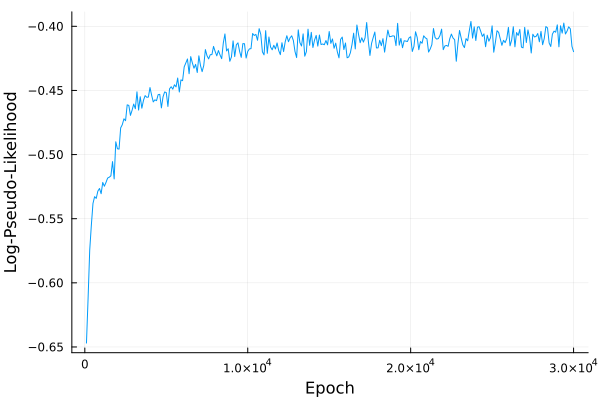

In [37]:
#Build data 
hidden_data5 = zeros(n_hidden5, data_shape[3])
for i in 1:data_shape[3]
    hidden_data5[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm5, hidden_data4[:,i]) 
end

logfile = open("./Log/Stacked6.txt", "w+")


n_hidden6 = 4
data = hidden_data5

rbm6 = center(RBM(Binary((n_hidden5,)), Binary((n_hidden6,)), zeros(n_hidden5, n_hidden6)));
initialize!(rbm6, data);

pcd!(
    rbm6, data; 
    batchsize=256, iters=30000, steps=10, optim=Adam(1f-3), l1_weights=1f-3,
    vm=hidden_data5[.., rand(1:size(hidden_data2)[end], 256)], callback
);

close(logfile)

logdata = readdlm("./Log/Stacked6.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")

In [38]:
#Build data 
hidden_data6 = zeros(n_hidden6, data_shape[3])
for i in 1:data_shape[3]
    hidden_data6[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm6, hidden_data5[:,i]) 
end


In [12]:
using JLD2
train = 0
if train == 1 
    jldsave("rbms.jld2"; rbm1, rbm2, rbm3, rbm4, rbm5, rbm6)
else 
    @load "rbms.jld2"
end

6-element Vector{Symbol}:
 :rbm1
 :rbm2
 :rbm3
 :rbm4
 :rbm5
 :rbm6

# Deeper and Deeper PCA representation

In [41]:
v_data_rot, expl_ratio_v, O_v = PCA(reshape(data_hits, (data_shape[1]*data_shape[2], data_shape[3])))
h1_data_rot, expl_ratio_h1, O_1 = PCA(hidden_data1)
h2_data_rot, expl_ratio_h2, O_2 = PCA(hidden_data2)
h3_data_rot, expl_ratio_h3, O_3 = PCA(hidden_data3)
h4_data_rot, expl_ratio_h4, O_4 = PCA(hidden_data4)
h5_data_rot, expl_ratio_h5, O_5 = PCA(hidden_data5)
h6_data_rot, expl_ratio_h6, O_6 = PCA(hidden_data6)




pca_v = [v_data_rot[end-i, :] for i in 0:3]
pca_h1 = [h1_data_rot[end-i, :] for i in 0:3]
pca_h2 = [h2_data_rot[end-i, :] for i in 0:3]
pca_h3 = [h3_data_rot[end-i, :] for i in 0:3]
pca_h4 = [h4_data_rot[end-i, :] for i in 0:3]
pca_h5 = [h5_data_rot[end-i, :] for i in 0:3]
pca_h6 = [h6_data_rot[end-i, :] for i in 0:3]



using DataFrames, StatsPlots
df_v =  DataFrame(PC1=pca_v[1], PC2=pca_v[2], PC3=pca_v[3], PC4=pca_v[4], Label=label[:,])
df_h1 = DataFrame(PC1=pca_h1[1], PC2=pca_h1[2], PC3=pca_h1[3], PC4=pca_h1[4], Label=label[:,])
df_h2 = DataFrame(PC1=pca_h2[1], PC2=pca_h2[2], PC3=pca_h2[3], PC4=pca_h2[4], Label=label[:,]) 
df_h3 = DataFrame(PC1=pca_h3[1], PC2=pca_h3[2], PC3=pca_h3[3], PC4=pca_h3[4], Label=label[:,]) 
df_h4 = DataFrame(PC1=pca_h4[1], PC2=pca_h4[2], PC3=pca_h4[3], PC4=pca_h4[4], Label=label[:,]) 
df_h5 = DataFrame(PC1=pca_h5[1], PC2=pca_h5[2], PC3=pca_h5[3], PC4=pca_h5[4], Label=label[:,]) 
df_h6 = DataFrame(PC1=pca_h6[1], PC2=pca_h6[2], PC3=pca_h6[3], PC4=pca_h6[4], Label=label[:,]) 




# exclude "other" from plotting 
#=
filter!(row -> row.Label .!= "other", df_v)
filter!(row -> row.Label .!= "other", df_h1)
filter!(row -> row.Label .!= "other", df_h2)
filter!(row -> row.Label .!= "other", df_h3) =#


Row,PC1,PC2,PC3,PC4,Label
,Float64,Float64,Float64,Float64,Any
1,-0.498051,-0.51832,-0.694964,0.0177548,Bacillota
2,-1.0227,-0.943624,0.00422428,0.25226,Bacillota
3,-1.0227,-0.943624,0.00422428,0.25226,Bacillota
4,-1.0227,-0.943624,0.00422428,0.25226,Bacillota
5,-0.0537055,-1.96615,0.0750224,0.354608,Bacillota
6,-0.0537055,-1.96615,0.0750224,0.354608,Bacillota
7,-0.0537055,-1.96615,0.0750224,0.354608,Bacillota
8,-0.524652,-0.425304,0.699188,0.234505,Bacillota
9,-1.0227,-0.943624,0.00422428,0.25226,Bacillota


In [ ]:
p1 = scatter(df_v.PC1 , df_v.PC2, markerstrokewidth=0.1, ms=3, group=df_v.Label, title="Visible PC1 vs PC2")
p2 = scatter(df_h1.PC1 , markerstrokewidth=0.1, ms=3, df_h1.PC2, group=df_h1.Label, title="Hidden1 PC1 vs PC2", legend=false)
p3 = scatter(df_h2.PC1 , markerstrokewidth=0.1, ms=3, df_h2.PC2, group=df_h2.Label, title="Hidden2 PC1 vs PC2", legend=false)
p4 = scatter(df_h3.PC1 , markerstrokewidth=0.1, ms=3, df_h3.PC2, group=df_h3.Label,title="Hidden3 PC1 vs PC2", legend=false)
p5 = scatter(df_h4.PC1 , markerstrokewidth=0.1, ms=3, df_h4.PC2, group=df_h4.Label, title="Hidden4 PC1 vs PC2", legend=false)
p6 = scatter(df_h5.PC1 , markerstrokewidth=0.1, ms=3, df_h5.PC2, group=df_h5.Label,title="Hidden5 PC1 vs PC2", legend=false)


plot(p1, p2, p3, p4, p5, p6, layout=(2,3), size=(1200,800))

In [ ]:
p1 = scatter(df_v.PC1 , markerstrokewidth=0.1, ms=3, df_v.PC3, group=df_v.Label, title="Visible PC1 vs PC3")
p2 = scatter(df_h1.PC1, markerstrokewidth=0.1, ms=3, df_h1.PC3, group=df_h1.Label, title="Hidden1 PC1 vs PC3", legend=false)
p3 = scatter(df_h2.PC1, markerstrokewidth=0.1, ms=3, df_h2.PC3, group=df_h2.Label, title="Hidden2 PC1 vs PC3", legend=false)
p4 = scatter(df_h3.PC1, markerstrokewidth=0.1, ms=3, df_h3.PC3, group=df_h3.Label,title="Hidden3 PC1 vs PC3", legend=false)


plot(p1, p2, p3, p4, layout=(2,2), size=(1200,800))

In [ ]:
p1 = scatter(df_v.PC2, markerstrokewidth=0.1, ms=3, df_v.PC3, group=df_v.Label, title="Visible PC2 vs PC3")
p2 = scatter(df_h1.PC2, markerstrokewidth=0.1, ms=3 , df_h1.PC3, group=df_h1.Label, title="Hidden1 PC2 vs PC3", legend=false)
p3 = scatter(df_h2.PC2, markerstrokewidth=0.1, ms=3 , df_h2.PC3, group=df_h2.Label, title="Hidden2 PC2 vs PC3", legend=false)
p4 = scatter(df_h3.PC2, markerstrokewidth=0.1, ms=3 , df_h3.PC3, group=df_h3.Label,title="Hidden3 PC2 vs PC3", legend=false)


plot(p1, p2, p3, p4, layout=(2,2), size=(1200,800))

# Checking Replica Exchange Probability

In [45]:
#Binary Case
function E_v(v_conf, rbm)
    Γ_sum = 0
    for μ in 1:length(rbm.hidden)
        Γ_sum += log( 2*cosh( rbm.hidden.θ[μ] + (Transpose(rbm.w)*v_conf)[μ] ))
    end 
    return - (dot(rbm.visible.θ, v_conf) + Γ_sum)
end

function E_h(h_conf, rbm)
    Γ_sum = 0
    for i in 1:length(rbm.visible)  
        Γ_sum += log( 2*cosh( rbm.visible.θ[i] + (rbm.w*h_conf)[i] ))
    end 
    return - (dot(rbm.hidden.θ, h_conf) + Γ_sum)
end

E_h (generic function with 1 method)

In [147]:
using RestrictedBoltzmannMachines: sample_h_from_v, sample_v_from_h
function A(rbm_n, rbm_nplus1, N_MC=1000)
    conf_init = rand(0:1,length(rbm_nplus1.visible))
    E_vnplus1_given_vnplus1 = [E_v(conf_init, rbm_nplus1)]
    E_hn_given_vnplus1 = [E_h(conf_init, rbm_n)]
    E_vplusone_given_hn = [E_v(conf_init, rbm_nplus1)]
    E_hn_given_hn = [E_h(conf_init, rbm_n)]

    conf_v_nplus1 = conf_init
    conf_h_n = conf_init

    for step in 1:N_MC
        #dynamics on rbm3:
        conf_h_temp = sample_h_from_v(rbm_nplus1, conf_v_nplus1)
        conf_v_nplus1 = sample_v_from_h(rbm_nplus1, conf_h_temp)

        #dynamics on rbm2:
        conf_v_temp = sample_v_from_h(rbm_n, conf_h_n)
        conf_h_n = sample_h_from_v(rbm_n, conf_v_temp)
        

        #compute energies:
        push!(E_vnplus1_given_vnplus1, E_v(conf_v_nplus1, rbm_nplus1))
        push!(E_hn_given_vnplus1, E_h(conf_v_nplus1, rbm_n))
        push!(E_vplusone_given_hn, E_v(conf_h_n, rbm_nplus1))
        push!(E_hn_given_hn, E_h(conf_h_n, rbm_n))
    end  
    return (E_vnplus1_given_vnplus1 .+ E_hn_given_hn).- (E_vplusone_given_hn .+ E_hn_given_vnplus1)
end 


A (generic function with 2 methods)

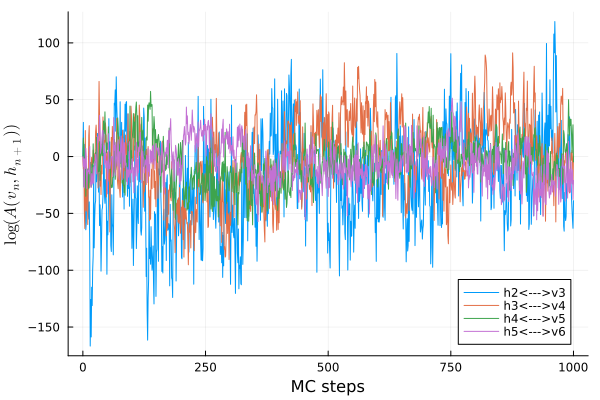

In [148]:
N_MC = 1000
plot(0:N_MC, A(rbm2, rbm3, N_MC), label="h2<--->v3")
plot!(0:N_MC, A(rbm3, rbm4, N_MC), label="h3<--->v4")
plot!(0:N_MC, A(rbm4, rbm5, N_MC), label="h4<--->v5")
plot!(0:N_MC, A(rbm5, rbm6, N_MC), label="h5<--->v6")
xlabel!("MC steps")
ylabel!(L"\log(A(v_n, h_{n+1}))")


# Statistics of Number of final Hidden toggles

## Distribution of number of turned on toggles
That is, take the final representation of a sequence (4 binary units) and check how many, out of the 4, are turne on. 

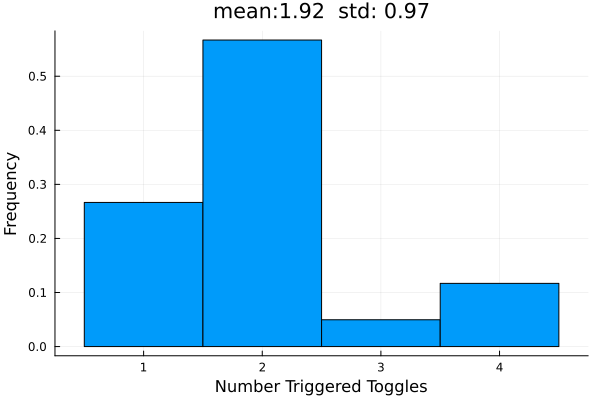

In [122]:
summed_seq = sum(hidden_data6, dims=1)
m = mean(summed_seq)
s = std(summed_seq)

b_range = range(0.5, 4.5, length=5)

histogram(Transpose(summed_seq), bins=b_range, normalize=:pdf, label=nothing)
xlabel!("Number Triggered Toggles")
ylabel!("Frequency")
title!("mean:$(round(m, digits=2))  std: $(round(s, digits=2))")

In [123]:
savefig("num_toggles.pdf")

"/Users/alessiogiorlandino/Desktop/SAM/num_toggles.pdf"

# Which toggle 

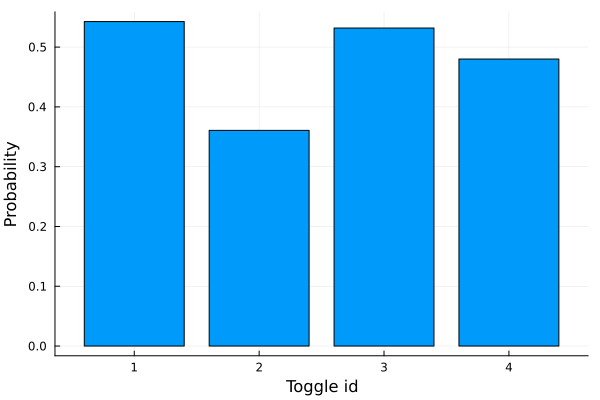

In [149]:
bar(1:4, mean(hidden_data6, dims=2), legend=false)
xlabel!("Toggle id")
ylabel!("Probability")

In [150]:
savefig("toggle_prob.pdf")

"/Users/alessiogiorlandino/Desktop/SAM/toggle_prob.pdf"

# Statistics of the sequences

In [54]:
using StatsBase: countmap
data_joined = [join(Int.(hidden_data6[:,i]), "") for i in 1:size(hidden_data6)[2]]
counts = countmap(data_joined)


Dict{String, Int64} with 16 entries:
  "0011" => 45
  "0110" => 37
  "1100" => 9
  "1011" => 147
  "0001" => 682
  "1001" => 17
  "1110" => 72
  "1101" => 19
  "1010" => 1887
  "0010" => 334
  "0101" => 1295
  "1111" => 679
  "1000" => 487
  "0100" => 44
  "0000" => 308
  "0111" => 50

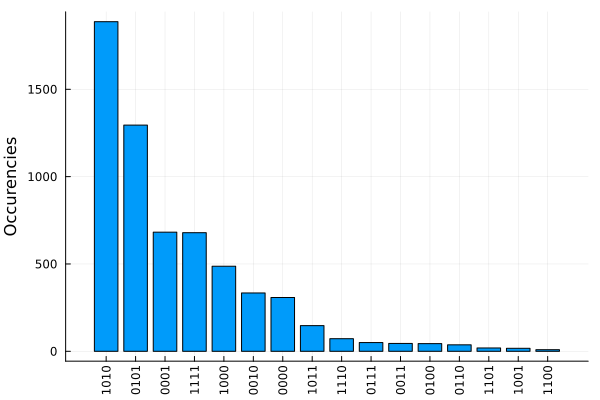

In [111]:
indipkey = collect(keys(counts))
vals  = collect(values(counts))
order = sortperm(vals, rev=true) 
indipkey = indipkey[order]
vals = vals[order]

bar(1:length(vals), vals, legend=false)
xticks!(1:length(vals), indipkey, xrotation =90)
ylabel!("Occurencies")

In [112]:
savefig("codes_distrib.pdf")

"/Users/alessiogiorlandino/Desktop/SAM/codes_distrib.pdf"

# Sampling Conditioned to the toggle config

In [25]:
function toggle_to_seq_pca_space(toggle_conf, Neq=100)
    v6 = sample_v_from_h(rbm6, toggle_conf)
    h5 = v6
    v5 = sample_v_from_h(rbm5, h5)
    h4 = v5 
    v4 = sample_v_from_h(rbm4, h4)
    h3 = v4 
    v3 = sample_v_from_h(rbm3, h3)
    h2 = v3
    v2 = sample_v_from_h(rbm2, h2)
    h1 = v2
    seq = sample_v_from_h(rbm1, h1)
    for i in 1:Neq
        htemp = sample_h_from_v(rbm1, seq)
        seq = sample_v_from_h(rbm1, htemp)
    end
    flat_seq = reshape(seq, data_shape[1]*data_shape[2])
    #rotate and get pcas
    rot_flat_seq = transpose(O_v)*flat_seq
    return [rot_flat_seq[end-i, :] for i in 0:3]
end

toggle_to_seq_pca_space (generic function with 2 methods)

In [26]:
Ndata = 2000

data1010=zeros(4, Ndata)
data0101=zeros(4, Ndata)
data0001=zeros(4, Ndata)
data0001=zeros(4, Ndata)
data1111=zeros(4, Ndata)
data1000=zeros(4, Ndata)
data0010=zeros(4, Ndata)
data0000=zeros(4, Ndata)
data1011=zeros(4, Ndata)




for k in  1:Ndata
    data1010[:,k] = reduce(vcat, toggle_to_seq_pca_space([1,0,1,0]))
    data0101[:,k] = reduce(vcat, toggle_to_seq_pca_space([0,1,0,1]))
    data0001[:,k] = reduce(vcat, toggle_to_seq_pca_space([0,0,0,1]))
    data1111[:,k] = reduce(vcat, toggle_to_seq_pca_space([1,1,1,1]))
    data1000[:,k] = reduce(vcat, toggle_to_seq_pca_space([1,0,0,0]))
    data0010[:,k] = reduce(vcat, toggle_to_seq_pca_space([0,0,1,0]))
    data0000[:,k] = reduce(vcat, toggle_to_seq_pca_space([0,0,0,0]))
    data1011[:,k] = reduce(vcat, toggle_to_seq_pca_space([1,0,1,1]))

end

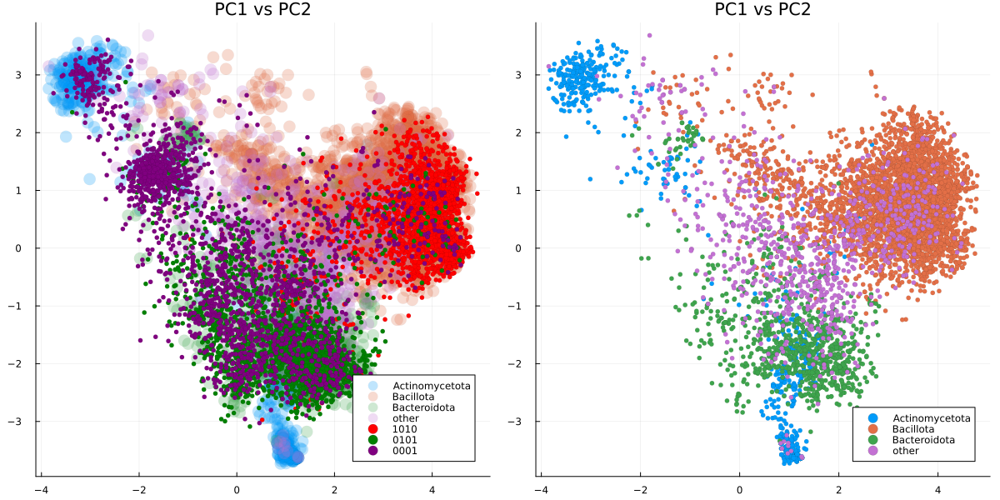

In [35]:
p1 = scatter(df_v.PC1, df_v.PC2, group=df_v.Label,markerstrokewidth=0, ms=8, markeralpha=0.25, title="PC1 vs PC2")
scatter!(data1010[1,:], data1010[2,:], label = "1010", color=:red, markerstrokewidth=0.05, ms=3)
scatter!(data0101[1,:], data0101[2,:], label = "0101", color=:green, markerstrokewidth=0.05, ms=3)
scatter!(data0001[1,:], data0001[2,:], label = "0001", color=:purple, markerstrokewidth=0.05, ms=3)
#scatter!(data1111[1,:], data1111[2,:], label = "1111", color=:orange, markerstrokewidth=0.05, ms=3)
#scatter!(data1000[1,:], data1000[2,:], label = "1000", color=:purple)
#scatter!(data0010[1,:], data0010[2,:], label = "0010'", color=:black)
#scatter!(data0000[1,:], data0000[2,:], label = "0000'", color=:black)
#scatter!(data1011[1,:], data1011[2,:], label = "1011'", color=:black)



p2 = scatter(df_v.PC1, df_v.PC2, group=df_v.Label, markerstrokewidth=0.05, ms=3, markeralpha=1, title="PC1 vs PC2")
plot(p1, p2, size = (1200,600))


In [157]:
savefig("encoding.pdf")

"/Users/alessiogiorlandino/Desktop/SAM/encoding.pdf"

# Logo Plots

In [38]:
function seq_generator(toggle_conf, Neq=200)
    v6 = sample_v_from_h(rbm6, toggle_conf)
    h5 = v6
    v5 = sample_v_from_h(rbm5, h5)
    h4 = v5 
    v4 = sample_v_from_h(rbm4, h4)
    h3 = v4 
    v3 = sample_v_from_h(rbm3, h3)
    h2 = v3
    v2 = sample_v_from_h(rbm2, h2)
    h1 = v2
    seq = sample_v_from_h(rbm1, h1)
    seq = RBMs.sample_v_from_h(rbm1, h1)
    for i in 1:Neq
        h_temp = sample_h_from_v(rbm1, seq)
        seq = sample_v_from_h(rbm1, h_temp)
    end
    return seq
end

seq_generator (generic function with 2 methods)

In [39]:
Ndata = 2000

seq1010=zeros(5, 108, Ndata)
seq0101=zeros(5, 108, Ndata)
seq0001=zeros(5, 108, Ndata)
#seq1111=zeros(5, 108, Ndata)


for k in  1:Ndata
    seq1010[:,:,k] = seq_generator([1,0,1,0])
    seq0101[:,:,k] = seq_generator([0,1,0,1])
    seq0001[:,:,k] = seq_generator([0,0,0,1])
    #seq1111[:,:,k] = seq_generator([1,1,1,1])
end

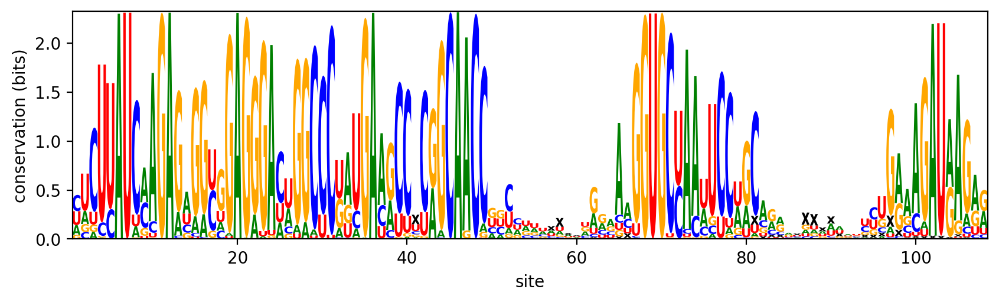

In [40]:
SamApp.seqlogo_entropic(reshape(mean(data_hits; dims=3), 5, 108)).fig

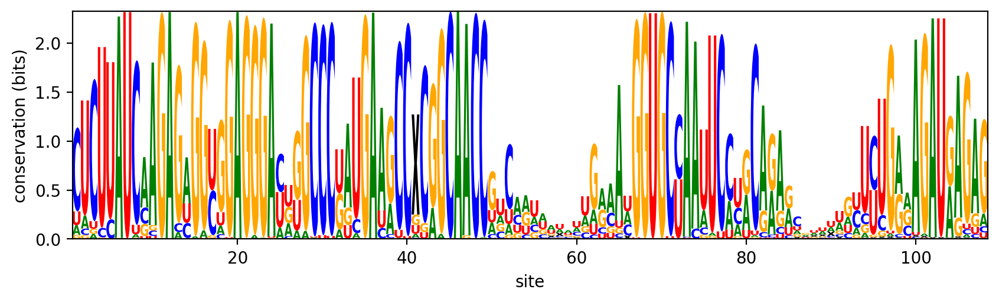

In [41]:
SamApp.seqlogo_entropic(reshape(mean(seq1010; dims=3), 5, 108)).fig

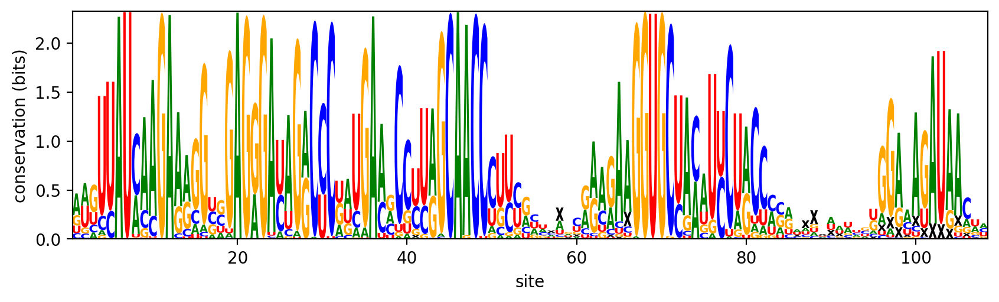

In [42]:
SamApp.seqlogo_entropic(reshape(mean(seq0101; dims=3), 5, 108)).fig

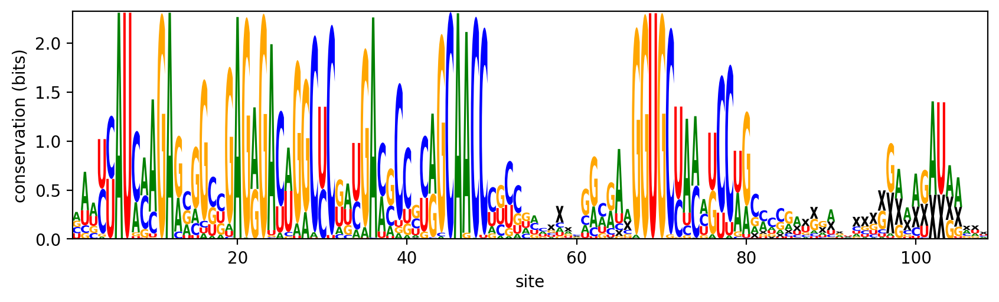

In [43]:
SamApp.seqlogo_entropic(reshape(mean(seq0001; dims=3), 5, 108)).fig

# Score Distribution

Evaluated on Jorge's RBM

In [51]:
rbm2022 = SamApp.rbm2022()
using RestrictedBoltzmannMachines: free_energy

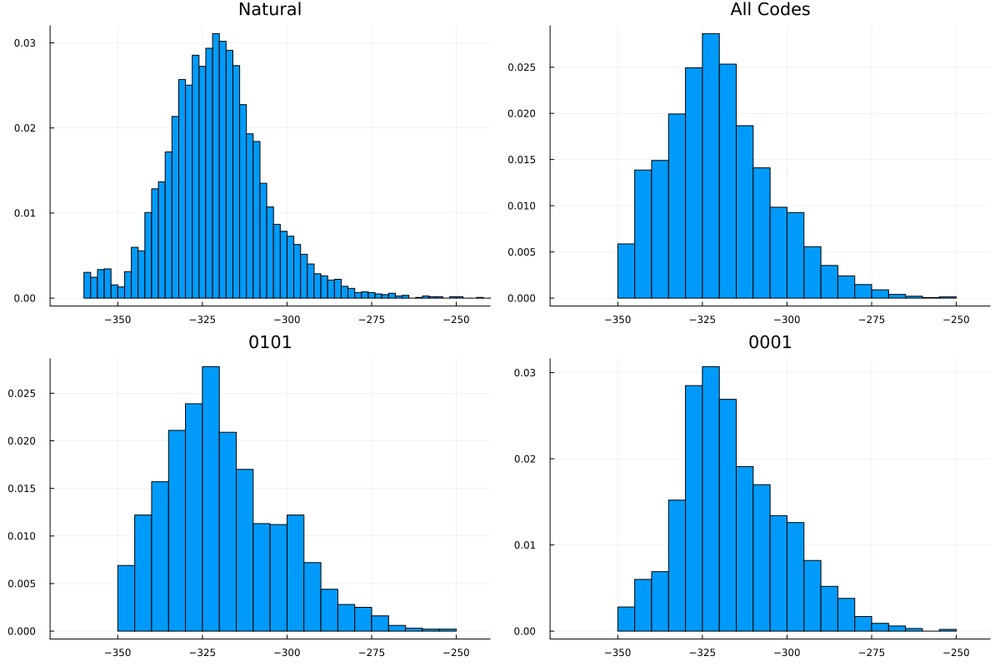

In [55]:
score_natural = [free_energy(rbm2022, data_hits[:,:,i]) for i in 1:size(data_hits)[3]]
score_1010 = [free_energy(rbm2022,seq1010[:,:,i]) for i in 1:Ndata]
score_0101 = [free_energy(rbm2022,seq0101[:,:,i]) for i in 1:Ndata]
score_0001 = [free_energy(rbm2022,seq0001[:,:,i]) for i in 1:Ndata]
#score_1111 = [free_energy(rbm2022, seq_generator([1,1,1,1])) for i in 1:10000]

p1=histogram(score_natural, normalize=:pdf, title= "Natural")
#p2=histogram(score_1010, normalize=:pdf, title= "1010")
p2=histogram(vcat(score_1010, score_0101, score_0001), normalize=:pdf, title= "All Codes")
p3=histogram(score_0101, normalize=:pdf, title= "0101")
p4=histogram(score_0001, normalize=:pdf, title= "0001")



plot(p1,p2,p3,p4, legend=false, size= (1200,800), xlims=(-370, -240))

In [189]:
savefig("score_distribution.pdf")

"/Users/alessiogiorlandino/Desktop/SAM/score_distribution.pdf"

# Infernal Sequences

In [ ]:
# CM model from Rfam (this has the noisy floor!)
Rfam_cm = Infernal.cmfetch(Rfam.cm(), "RF00162");
# emit sequences from Rfam CM model
Rfam_cm_emitted_sequences_afa = Infernal.cmemit(Infernal.cmfetch(Rfam.cm(), "RF00162").out; N=10000, aligned=true, outformat="AFA");
Rfam_cm_emitted_sequences = FASTX.sequence.(FASTX.FASTA.Reader(open(Rfam_cm_emitted_sequences_afa.out)));
# remove inserts
Rfam_cm_emitted_sequences = [filter(!=('.'), filter(!islowercase, seq)) for seq in Rfam_cm_emitted_sequences];
@assert only(unique(length.(Rfam_cm_emitted_sequences))) == 108
Rfam_cm_emitted_sequences = LongRNA{4}.(Rfam_cm_emitted_sequences);
# aligned hits, used to train a Refined CM model (in Stockholm format, without inserts!)
RF00162_hits_stk = Infernal.cmalign(Infernal.cmfetch(Rfam.cm(), "RF00162").out, Rfam.fasta_file("RF00162"); matchonly=true);
# fit refined CM model using full alignment (without inserts), and without entropic noise
Refined_cm = Infernal.cmbuild(RF00162_hits_stk.out; enone=true);

# emit sequences from Refined CM model
Refined_cm_emitted_sequences_afa = Infernal.cmemit(Refined_cm.cmout; N=10000, aligned=true, outformat="AFA");
Refined_cm_emitted_sequences = FASTX.sequence.(FASTX.FASTA.Reader(open(Refined_cm_emitted_sequences_afa.out)));
# remove inserts
Refined_cm_emitted_sequences = [filter(!=('.'), filter(!islowercase, seq)) for seq in Refined_cm_emitted_sequences];
@assert only(unique(length.(Refined_cm_emitted_sequences))) == 108
Refined_cm_emitted_sequences = LongRNA{4}.(Refined_cm_emitted_sequences);

infernal_seq = SamApp.onehot(Refined_cm_emitted_sequences)

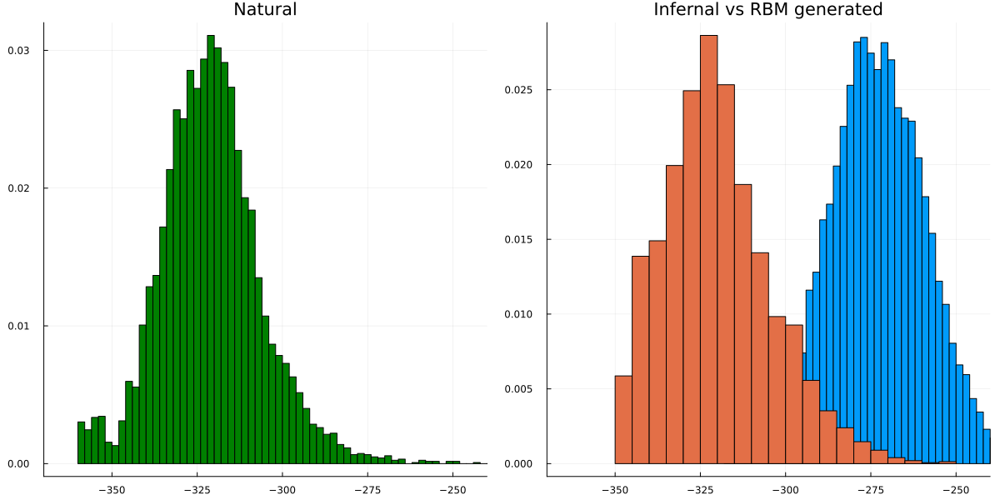

In [67]:
E_infernal = [free_energy(rbm2022, infernal_seq[:,:,i]) for i in 1:size(infernal_seq)[3]]
histogram(E_infernal, legend=false, title="Infernal", normalize=:pdf)

p1=histogram(score_natural, normalize=:pdf, title= "Natural", color=:green, legend=false)
xlims!((-370, -240))

p2=histogram([E_infernal, vcat(score_1010, score_0101, score_0001)], legend= false, title="Infernal vs RBM generated", normalize=:pdf)
xlims!((-370, -240))


plot(p1,p2, size= (1200,600))

In [197]:
savefig("energy_distribution_cases.pdf")

"/Users/alessiogiorlandino/Desktop/SAM/energy_distribution_cases.pdf"

In [69]:
function rotate_along_pca(collection)
    data = zeros(size(collection)[3],2)
    for i in 1:size(collection)[3]
        data[i,:]=(transpose(O_v)*reshape(collection[:,:,i], (data_shape[1]*data_shape[2])))[end-1:end]
    end
    return data
end



rotate_along_pca (generic function with 1 method)

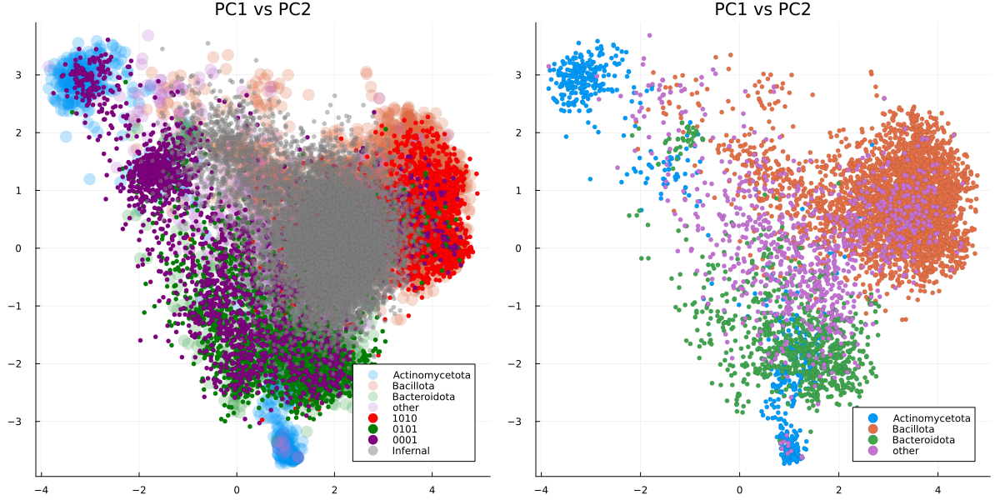

In [74]:
p1 = scatter(df_v.PC1, df_v.PC2, group=df_v.Label,markerstrokewidth=0, ms=8, markeralpha=0.25, title="PC1 vs PC2")
scatter!(data1010[1,:], data1010[2,:], label = "1010", color=:red, markerstrokewidth=0.05, ms=3)
scatter!(data0101[1,:], data0101[2,:], label = "0101", color=:green, markerstrokewidth=0.05, ms=3)
scatter!(data0001[1,:], data0001[2,:], label = "0001", color=:purple, markerstrokewidth=0.05, ms=3)
scatter!(rotate_along_pca(infernal_seq)[:,2], rotate_along_pca(infernal_seq)[:,1], label = "Infernal", markeralpha=0.5, color=:grey, markerstrokewidth=0.05, ms=3)


p2 = scatter(df_v.PC1, df_v.PC2, group=df_v.Label, markerstrokewidth=0.05, ms=3, markeralpha=1, title="PC1 vs PC2")
plot(p1, p2, size = (1200,600))

# What codes is Infernal Triggering ? 

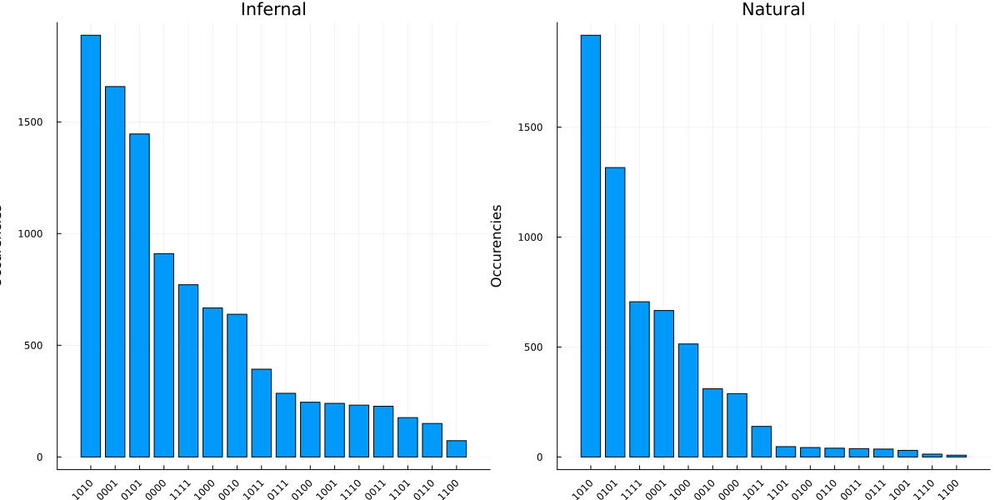

In [93]:
function encoder(config)
    h1 = sample_h_from_v(rbm1, config)
    v2 = h1
    h2 = sample_h_from_v(rbm2, v2)
    v3 = h2
    h3 = sample_h_from_v(rbm3, v3)
    v4 = h3
    h4 = sample_h_from_v(rbm4, v4)
    v5 = h4 
    h5 = sample_h_from_v(rbm5, v5)
    v6 = h5
    h6 = sample_h_from_v(rbm6, v6)
    return h6
end

#Infernal
infcodes = [encoder(infernal_seq[:,:,i]) for i in 1:size(infernal_seq)[3]]
using StatsBase: countmap
data_joined = [join(Int.(infcodes[i]), "") for i in 1:length(infcodes)]
infcounts = countmap(data_joined)
indipkey = collect(keys(infcounts))
infvals  = collect(values(infcounts))
order = sortperm(infvals, rev=true) 
natindipkey = indipkey[order]
infvals = infvals[order]

p1=bar(1:length(infvals), infvals, legend=false, title="Infernal")
xticks!(1:length(infvals), natindipkey, xrotation =45)
ylabel!("Occurencies")

#Natural
natcodes = [encoder(data_hits[:,:,i]) for i in 1:size(data_hits)[3]]
data_joined = [join(Int.(natcodes[i]), "") for i in 1:length(natcodes)]
natcounts = countmap(data_joined)
natindipkey = collect(keys(natcounts))
natvals  = collect(values(natcounts))
order = sortperm(natvals, rev=true) 
natindipkey = indipkey[order]
natvals = natvals[order]

p2=bar(1:length(natvals), natvals, legend=false, title="Natural")
xticks!(1:length(vals), natindipkey, xrotation =45)
ylabel!("Occurencies")

plot(p1, p2, size = (1200,600))